In [1]:
import pandas as pd
import numpy as np
import catboost 
import os
import xgboost as xgb
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression



from statsmodels.regression.linear_model import OLS;
from statsmodels.tsa.stattools import kpss;
from statsmodels.tsa.stattools import acf;
from statsmodels.tsa.stattools import pacf;
from statsmodels.graphics.tsaplots import plot_acf;
from statsmodels.graphics.tsaplots import plot_pacf;
from statsmodels.tsa.arima.model import ARIMA;



#import arima

data_dir = r'C:\Users\ivant\Desktop\proj\data\kaggle\playground-series-s5e3'

# 1. Загрузка данных
train = pd.read_csv(os.path.join(data_dir, 'train.csv'), index_col=['id'])
test = pd.read_csv(os.path.join(data_dir, 'test.csv'), index_col=['id'])


dfs = [train,test]
all_in = pd.concat(dfs)
all_in = all_in.drop('rainfall', axis=1)
all_in

,day,pressure,maxtemp,temparature,mintemp,dewpoint,humidity,cloud,sunshine,winddirection,windspeed
id,,,,,,,,,,,
0,1,1017.4,21.2,20.6,19.9,19.4,87.0,88.0,1.1,60.0,17.2
1,2,1019.5,16.2,16.9,15.8,15.4,95.0,91.0,0.0,50.0,21.9
2,3,1024.1,19.4,16.1,14.6,9.3,75.0,47.0,8.3,70.0,18.1
3,4,1013.4,18.1,17.8,16.9,16.8,95.0,95.0,0.0,60.0,35.6
4,5,1021.8,21.3,18.4,15.2,9.6,52.0,45.0,3.6,40.0,24.8
...,...,...,...,...,...,...,...,...,...,...,...
2915,361,1020.8,18.2,17.6,16.1,13.7,96.0,95.0,0.0,20.0,34.3
2916,362,1011.7,23.2,18.1,16.0,16.0,78.0,80.0,1.6,40.0,25.2
2917,363,1022.7,21.0,18.5,17.0,15.5,92.0,96.0,0.0,50.0,21.9


In [ ]:
'''all_in['temdelt'] = all_in['maxtemp']-all_in['mintemp']
all_in.drop(['maxtemp','mintemp'],axis=1)'''

In [ ]:
'''pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler()),
    ('classifier', LogisticRegression())
])

pipeline.fit(X_train, y_train)'''

day


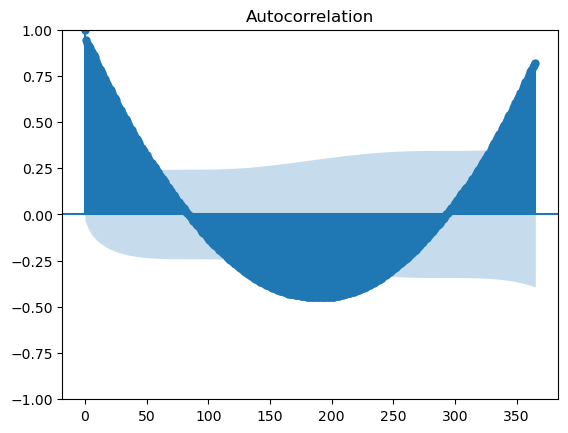

pressure


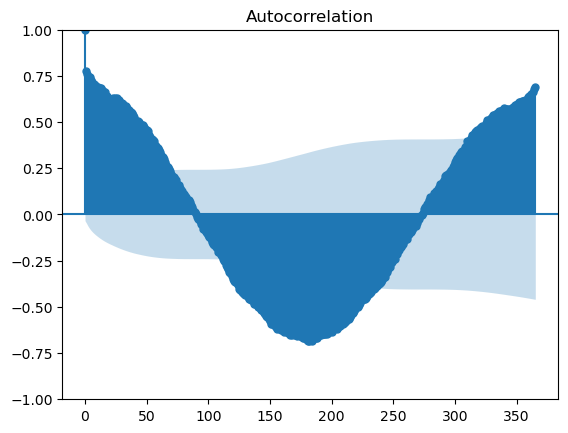

maxtemp


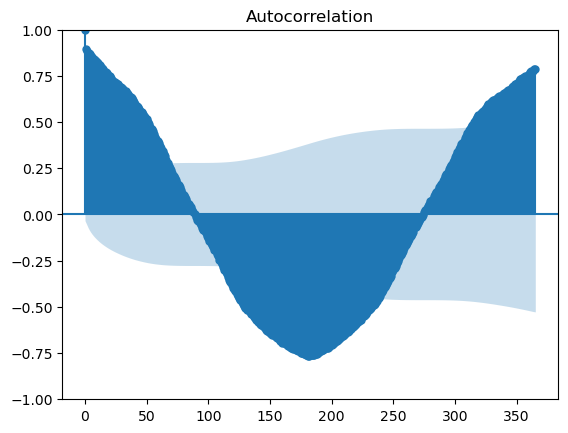

temparature


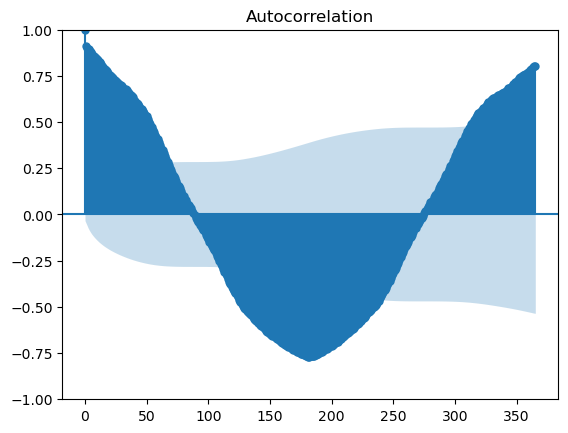

mintemp


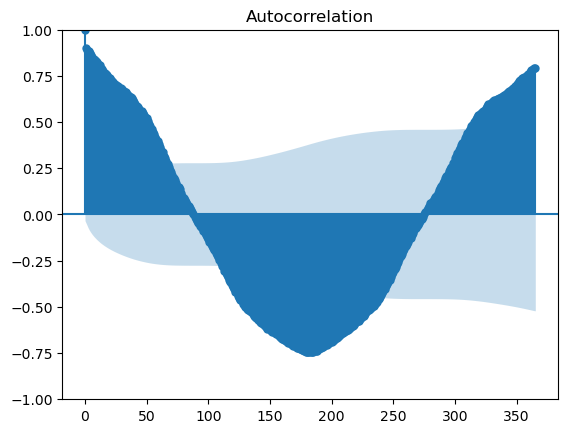

dewpoint


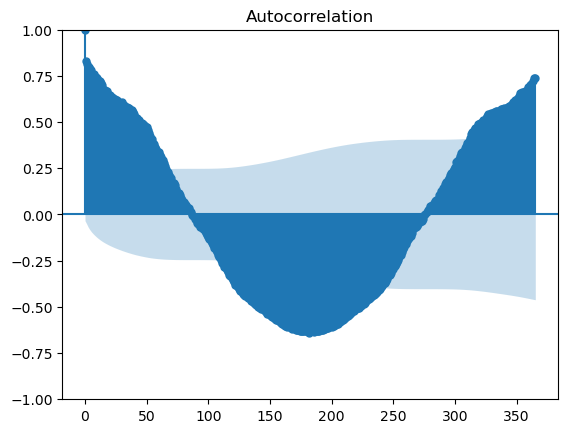

humidity


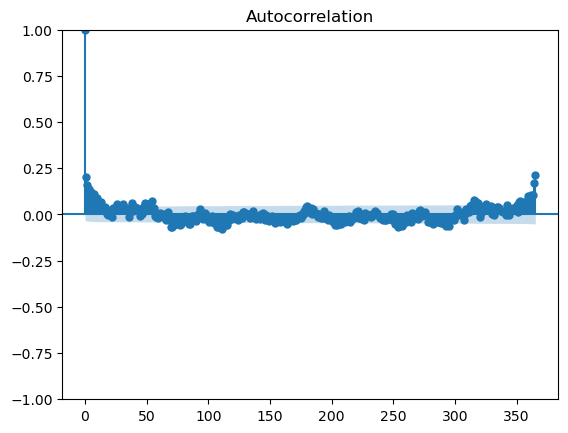

cloud


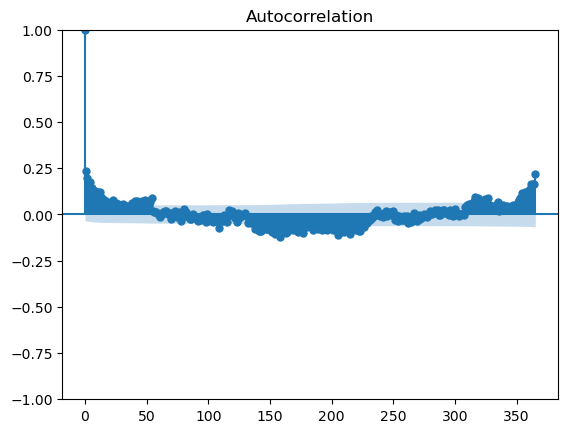

sunshine


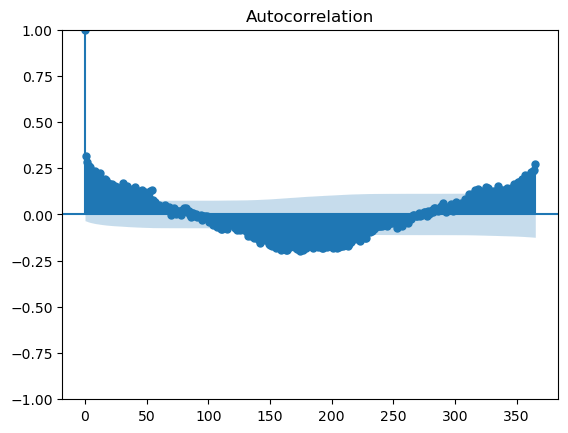

winddirection


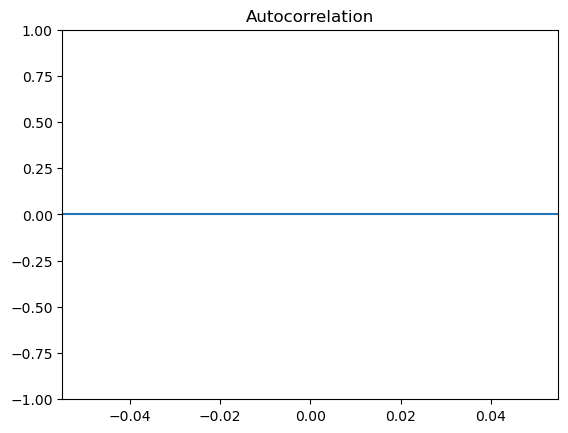

windspeed


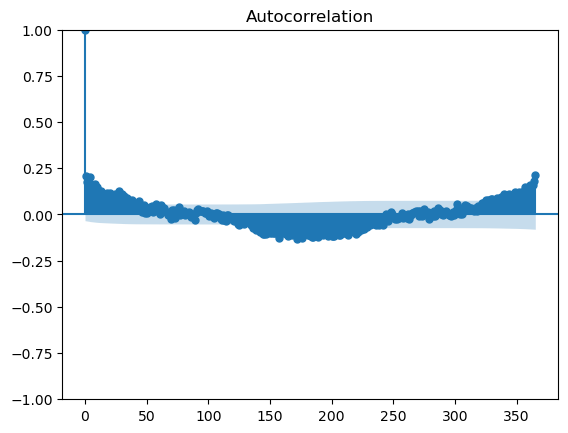

temdelt


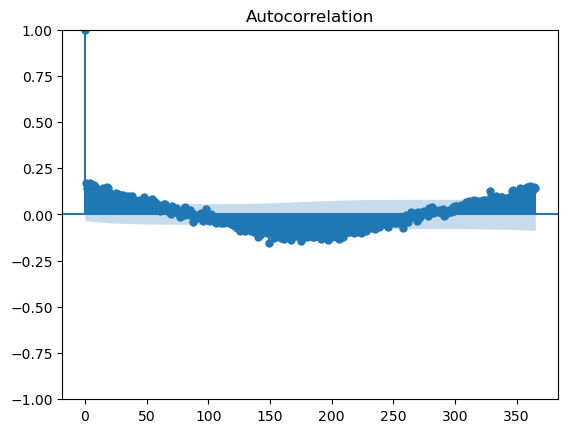

In [88]:
for i in all_in.columns:
    print(i)
    fig = plot_acf(all_in[i],use_vlines=True, lags = 365)
    #fig = plot_pacf(all_in[i])
    plt.show()
    '''plt.plot(all_in[i])
    plt.show()
    plt.scatter(all_in.index,all_in[i] )
    plt.show()'''

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler


def transform_columns(df):
    # Преобразование столбца 'day' в циклические признаки (предполагается, что day от 1 до 365)
    df['day_sin'] = np.sin(2 * np.pi * df['day'] / 365)
    df['day_cos'] = np.cos(2 * np.pi * df['day'] / 365)
    
    # Преобразование столбца 'winddirection' (угол в градусах) в синус и косинус
    df['winddirection_sin'] = np.sin(np.deg2rad(df['winddirection']))
    df['winddirection_cos'] = np.cos(np.deg2rad(df['winddirection']))
    
    # Список остальных числовых признаков, которые будем масштабировать
    numeric_cols = ['pressure', 'maxtemp', 'temparature', 'mintemp', 'dewpoint', 'humidity', 'cloud', 'sunshine', 'windspeed']
    
    scaler = StandardScaler()
    df[numeric_cols] = scaler.fit_transform(df[numeric_cols])
    
    # Если столбец 'winddirection' больше не нужен, его можно удалить
    df.drop('winddirection', axis=1, inplace=True)
    
    # При необходимости можно также удалить исходный столбец 'day'
    # df.drop('day', axis=1, inplace=True)
    
    return df

# Пример использования:
df_transformed = transform_columns(all_in)
df_transformed

,day,pressure,maxtemp,temparature,mintemp,dewpoint,humidity,cloud,sunshine,windspeed,day_sin,day_cos,winddirection_sin,winddirection_cos
id,,,,,,,,,,,,,,
0,1,0.680593,-0.913473,-0.641047,-0.443439,-0.198771,0.615466,0.673271,-0.723281,-0.481616,1.721336e-02,0.999852,0.866025,0.500000
1,2,1.054482,-1.797343,-1.347884,-1.249644,-0.951720,1.640146,0.839943,-1.026438,-0.007524,3.442161e-02,0.999407,0.766044,0.642788
2,3,1.873479,-1.231666,-1.500714,-1.485606,-2.099967,-0.921554,-1.604580,1.261016,-0.390833,5.161967e-02,0.998667,0.939693,0.342020
3,4,-0.031578,-1.461472,-1.175951,-1.033345,-0.688188,1.640146,1.062173,-1.026438,1.374405,6.880243e-02,0.997630,0.866025,0.500000
4,5,1.463981,-0.895796,-1.061329,-1.367625,-2.043495,-3.867510,-1.715695,-0.034289,0.285001,8.596480e-02,0.996298,0.642788,0.766044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2915,361,1.285938,-1.443795,-1.214158,-1.190653,-1.271723,1.768231,1.062173,-1.026438,1.243273,-6.880243e-02,0.997630,0.342020,0.939693
2916,362,-0.334251,-0.559925,-1.118640,-1.210317,-0.838777,-0.537299,0.228813,-0.585483,0.325349,-5.161967e-02,0.998667,0.642788,0.766044
2917,363,1.624219,-0.948828,-1.042225,-1.013681,-0.932896,1.255891,1.117730,-1.026438,-0.007524,-3.442161e-02,0.999407,0.766044,0.642788


# Score: 0.81858

In [98]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostClassifier
from sklearn.ensemble import RandomForestClassifier

# Функция для преобразования признаков
def transform_columns(df, scaler=None, fit_scaler=True):
    # Преобразование 'day' в циклические признаки (предполагается, что day от 1 до 365)
    df['day_sin'] = np.sin(2 * np.pi * df['day'] / 365)
    df['day_cos'] = np.cos(2 * np.pi * df['day'] / 365)
    
    # Преобразование 'winddirection' (угол в градусах) в синус и косинус
    df['winddirection_sin'] = np.sin(np.deg2rad(df['winddirection']))
    df['winddirection_cos'] = np.cos(np.deg2rad(df['winddirection']))
    
    # Список числовых признаков для масштабирования
    numeric_cols = ['pressure', 'maxtemp', 'temparature', 'mintemp', 
                    'dewpoint', 'humidity', 'cloud', 'sunshine', 'windspeed']
    
    if fit_scaler:
        scaler = StandardScaler()
        df[numeric_cols] = scaler.fit_transform(df[numeric_cols])
    else:
        df[numeric_cols] = scaler.transform(df[numeric_cols])
    
    # Удаляем исходные признаки, которые были преобразованы (если они не нужны модели)
    df.drop(['winddirection', 'day'], axis=1, inplace=True)
    
    return df, scaler

data_dir = r'C:\Users\ivant\Desktop\proj\data\kaggle\playground-series-s5e3'

# 1. Загрузка данных
train = pd.read_csv(os.path.join(data_dir, 'train.csv'), index_col=['id'])
test = pd.read_csv(os.path.join(data_dir, 'test.csv'), index_col=['id'])

# Предполагается, что целевая переменная называется 'rain'
y = train['rainfall']
train.drop('rainfall', axis=1, inplace=True)

# Преобразование данных
train, scaler = transform_columns(train, fit_scaler=True)
test, _ = transform_columns(test, scaler=scaler, fit_scaler=False)

# Список признаков после преобразования
features = train.columns.tolist()

# Разбиение тренировочного набора для локальной валидации
X_train, X_val, y_train, y_val = train_test_split(train, y, test_size=0.2, 
                                                  random_state=42, stratify=y)

# Инициализация модели LightGBM
model = lgb.LGBMClassifier(n_estimators=1000, learning_rate=0.01, random_state=42)

# Обучение модели с ранней остановкой
model.fit(X_train, y_train, 
          eval_set=[(X_val, y_val)], 
          eval_metric='auc')

# Оценка качества на валидационном наборе
val_preds = model.predict_proba(X_val)[:, 1]
auc = roc_auc_score(y_val, val_preds)
print(f'Validation ROC-AUC: {auc:.4f}')

# Обучение финальной модели на всем тренировочном наборе с использованием лучшего количества итераций
best_iter = model.best_iteration_
final_model = lgb.LGBMClassifier(n_estimators=1, learning_rate=0.01, random_state=42)
final_model.fit(train, y)

# Предсказание на тестовом наборе
test_preds = final_model.predict_proba(test)[:, 1]

# Формирование файла сабмишена
# Если в тестовом наборе отсутствует столбец 'id', можно создать его как индекс
if 'id' in test.columns:
    submission = pd.DataFrame({'id': test['id'], 'rainfall': test_preds})
else:
    submission = pd.DataFrame({'id': test.index, 'rainfall': test_preds})

submission.to_csv('submission.csv', index=False)
print("Файл submission.csv создан!")

[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0,000953 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1820
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0,753425 -> initscore=1,116961
[LightGBM] [Info] Start training from score 1,116961
Validation ROC-AUC: 0.8558
[LightGBM] [Info] Number of positive: 1650, number of negative: 540
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0,000263 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1867
[LightGBM] [Info] Number of data points in the train set: 2190, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0,753425 -> inits

# Score: 0.84928

In [103]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostClassifier
from sklearn.ensemble import RandomForestClassifier

# Функция для преобразования признаков
def transform_columns(df, scaler=None, fit_scaler=True):
    # Преобразование 'day' в циклические признаки (предполагается, что day от 1 до 365)
    df['day_sin'] = np.sin(2 * np.pi * df['day'] / 365)
    df['day_cos'] = np.cos(2 * np.pi * df['day'] / 365)
    
    # Преобразование 'winddirection' (угол в градусах) в синус и косинус
    df['winddirection_sin'] = np.sin(np.deg2rad(df['winddirection']))
    df['winddirection_cos'] = np.cos(np.deg2rad(df['winddirection']))
    
    # Список числовых признаков для масштабирования
    numeric_cols = ['pressure', 'maxtemp', 'temparature', 'mintemp', 
                    'dewpoint', 'humidity', 'cloud', 'sunshine', 'windspeed']
    
    if fit_scaler:
        scaler = StandardScaler()
        df[numeric_cols] = scaler.fit_transform(df[numeric_cols])
    else:
        df[numeric_cols] = scaler.transform(df[numeric_cols])
    
    # Удаляем исходные признаки, которые были преобразованы (если они не нужны модели)
    df.drop(['winddirection', 'day'], axis=1, inplace=True)
    
    return df, scaler

data_dir = r'C:\Users\ivant\Desktop\proj\data\kaggle\playground-series-s5e3'

# 1. Загрузка данных
train = pd.read_csv(os.path.join(data_dir, 'train.csv'), index_col=['id'])
test = pd.read_csv(os.path.join(data_dir, 'test.csv'), index_col=['id'])

# Предполагается, что целевая переменная называется 'rain'
y = train['rainfall']
train.drop('rainfall', axis=1, inplace=True)

# Применяем преобразования к тренировочным и тестовым данным
train, scaler = transform_columns(train, fit_scaler=True)
test, _ = transform_columns(test, scaler=scaler, fit_scaler=False)

# Список признаков после преобразования
features = train.columns.tolist()

# Подготовка кросс-валидации
folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Инициализация массивов для предсказаний (out-of-fold и тестовых)
oof_preds_lgb = np.zeros(len(train))
oof_preds_xgb = np.zeros(len(train))
oof_preds_cb  = np.zeros(len(train))
oof_preds_rf  = np.zeros(len(train))

test_preds_lgb = np.zeros(len(test))
test_preds_xgb = np.zeros(len(test))
test_preds_cb  = np.zeros(len(test))
test_preds_rf  = np.zeros(len(test))

# Цикл по фолдам
for fold, (train_idx, valid_idx) in enumerate(folds.split(train, y)):
    print(f"Обработка фолда {fold+1}")
    X_train, y_train = train.iloc[train_idx], y.iloc[train_idx]
    X_valid, y_valid = train.iloc[valid_idx], y.iloc[valid_idx]
    
    # --- LightGBM ---
    lgb_model = lgb.LGBMClassifier(n_estimators=1000, learning_rate=0.01, random_state=42)
    lgb_model.fit(X_train, y_train,
                  eval_set=[(X_valid, y_valid)],
                  eval_metric='auc')
    oof_preds_lgb[valid_idx] = lgb_model.predict_proba(X_valid)[:,1]
    test_preds_lgb += lgb_model.predict_proba(test)[:,1] / folds.n_splits
    
    # --- XGBoost ---
    xgb_model = xgb.XGBClassifier(n_estimators=1000, learning_rate=0.01, random_state=42, 
                                  use_label_encoder=False, eval_metric='auc')
    xgb_model.fit(X_train, y_train,
                  eval_set=[(X_valid, y_valid)])
    oof_preds_xgb[valid_idx] = xgb_model.predict_proba(X_valid)[:,1]
    test_preds_xgb += xgb_model.predict_proba(test)[:,1] / folds.n_splits
    
    # --- CatBoost ---
    cb_model = CatBoostClassifier(iterations=1000, learning_rate=0.01, random_seed=42, 
                                  verbose=100, early_stopping_rounds=50)
    cb_model.fit(X_train, y_train, eval_set=(X_valid, y_valid))
    oof_preds_cb[valid_idx] = cb_model.predict_proba(X_valid)[:,1]
    test_preds_cb += cb_model.predict_proba(test)[:,1] / folds.n_splits
    
    # --- RandomForest ---
    rf_model = RandomForestClassifier(n_estimators=200, random_state=42)
    rf_model.fit(X_train, y_train)
    oof_preds_rf[valid_idx] = rf_model.predict_proba(X_valid)[:,1]
    test_preds_rf += rf_model.predict_proba(test)[:,1] / folds.n_splits

# Вычисление ROC-AUC для каждой модели по out-of-fold предсказаниям
auc_lgb = roc_auc_score(y, oof_preds_lgb)
auc_xgb = roc_auc_score(y, oof_preds_xgb)
auc_cb  = roc_auc_score(y, oof_preds_cb)
auc_rf  = roc_auc_score(y, oof_preds_rf)

print(f'LightGBM AUC: {auc_lgb:.4f}')
print(f'XGBoost AUC: {auc_xgb:.4f}')
print(f'CatBoost AUC:  {auc_cb:.4f}')
print(f'RandomForest AUC: {auc_rf:.4f}')

# Ансамблирование моделей (среднее арифметическое)
ensemble_oof = (oof_preds_lgb + oof_preds_xgb + oof_preds_cb + oof_preds_rf) / 4.0
ensemble_auc = roc_auc_score(y, ensemble_oof)
print(f'Ensemble OOF AUC: {ensemble_auc:.4f}')

ensemble_test = (test_preds_lgb + test_preds_xgb + test_preds_cb + test_preds_rf) / 4.0

# Формирование файла сабмишена
# Если в тестовом наборе отсутствует столбец 'id', можно создать его как индекс
if 'id' in test.columns:
    submission = pd.DataFrame({'id': test['id'], 'rainfall': ensemble_test})
else:
    submission = pd.DataFrame({'id': test.index, 'rainfall': ensemble_test})

submission.to_csv('submission.csv', index=False)
print("Файл submission.csv создан!")

Обработка фолда 1
[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0,000493 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1816
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0,753425 -> initscore=1,116961
[LightGBM] [Info] Start training from score 1,116961
[0]	validation_0-auc:0.88258
[1]	validation_0-auc:0.88437
[2]	validation_0-auc:0.89018
[3]	validation_0-auc:0.89028
[4]	validation_0-auc:0.89105
[5]	validation_0-auc:0.88942
[6]	validation_0-auc:0.88913
[7]	validation_0-auc:0.88921
[8]	validation_0-auc:0.89014
[9]	validation_0-auc:0.89097
[10]	validation_0-auc:0.88973
[11]	validation_0-auc:0.88977
[12]	validation_0-auc:0.88932
[13]	validation_0-auc:0.89192
[14]	validation_0-auc:0.89221
[15]	validation_0-auc:0.89126
[16]	validation_0-auc:0.

C:\Users\ivant\AppData\Roaming\Python\Python312\site-packages\xgboost\core.py:158: UserWarning: [14:56:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[38]	validation_0-auc:0.89969
[39]	validation_0-auc:0.90062
[40]	validation_0-auc:0.90104
[41]	validation_0-auc:0.90098
[42]	validation_0-auc:0.90177
[43]	validation_0-auc:0.90163
[44]	validation_0-auc:0.90174
[45]	validation_0-auc:0.90174
[46]	validation_0-auc:0.90177
[47]	validation_0-auc:0.90210
[48]	validation_0-auc:0.90269
[49]	validation_0-auc:0.90337
[50]	validation_0-auc:0.90373
[51]	validation_0-auc:0.90383
[52]	validation_0-auc:0.90411
[53]	validation_0-auc:0.90460
[54]	validation_0-auc:0.90469
[55]	validation_0-auc:0.90508
[56]	validation_0-auc:0.90497
[57]	validation_0-auc:0.90434
[58]	validation_0-auc:0.90450
[59]	validation_0-auc:0.90484
[60]	validation_0-auc:0.90490
[61]	validation_0-auc:0.90450
[62]	validation_0-auc:0.90448
[63]	validation_0-auc:0.90464
[64]	validation_0-auc:0.90473
[65]	validation_0-auc:0.90467
[66]	validation_0-auc:0.90478
[67]	validation_0-auc:0.90478
[68]	validation_0-auc:0.90473
[69]	validation_0-auc:0.90464
[70]	validation_0-auc:0.90470
[71]	valid

C:\Users\ivant\AppData\Roaming\Python\Python312\site-packages\xgboost\core.py:158: UserWarning: [14:57:03] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[51]	validation_0-auc:0.84059
[52]	validation_0-auc:0.84028
[53]	validation_0-auc:0.83962
[54]	validation_0-auc:0.83937
[55]	validation_0-auc:0.83920
[56]	validation_0-auc:0.83920
[57]	validation_0-auc:0.84168
[58]	validation_0-auc:0.84185
[59]	validation_0-auc:0.84118
[60]	validation_0-auc:0.84179
[61]	validation_0-auc:0.84185
[62]	validation_0-auc:0.84258
[63]	validation_0-auc:0.84262
[64]	validation_0-auc:0.84155
[65]	validation_0-auc:0.84155
[66]	validation_0-auc:0.84074
[67]	validation_0-auc:0.84097
[68]	validation_0-auc:0.84068
[69]	validation_0-auc:0.84139
[70]	validation_0-auc:0.84127
[71]	validation_0-auc:0.84111
[72]	validation_0-auc:0.84133
[73]	validation_0-auc:0.84125
[74]	validation_0-auc:0.84049
[75]	validation_0-auc:0.84071
[76]	validation_0-auc:0.84032
[77]	validation_0-auc:0.83965
[78]	validation_0-auc:0.83976
[79]	validation_0-auc:0.83979
[80]	validation_0-auc:0.83967
[81]	validation_0-auc:0.84012
[82]	validation_0-auc:0.84004
[83]	validation_0-auc:0.83972
[84]	valid

C:\Users\ivant\AppData\Roaming\Python\Python312\site-packages\xgboost\core.py:158: UserWarning: [14:57:10] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[42]	validation_0-auc:0.85146
[43]	validation_0-auc:0.85286
[44]	validation_0-auc:0.85303
[45]	validation_0-auc:0.85289
[46]	validation_0-auc:0.85342
[47]	validation_0-auc:0.85320
[48]	validation_0-auc:0.85311
[49]	validation_0-auc:0.85354
[50]	validation_0-auc:0.85390
[51]	validation_0-auc:0.85455
[52]	validation_0-auc:0.85499
[53]	validation_0-auc:0.85474
[54]	validation_0-auc:0.85467
[55]	validation_0-auc:0.85495
[56]	validation_0-auc:0.85506
[57]	validation_0-auc:0.85484
[58]	validation_0-auc:0.85512
[59]	validation_0-auc:0.85467
[60]	validation_0-auc:0.85478
[61]	validation_0-auc:0.85473
[62]	validation_0-auc:0.85490
[63]	validation_0-auc:0.85487
[64]	validation_0-auc:0.85473
[65]	validation_0-auc:0.85480
[66]	validation_0-auc:0.85421
[67]	validation_0-auc:0.85455
[68]	validation_0-auc:0.85368
[69]	validation_0-auc:0.85410
[70]	validation_0-auc:0.85365
[71]	validation_0-auc:0.85370
[72]	validation_0-auc:0.85356
[73]	validation_0-auc:0.85393
[74]	validation_0-auc:0.85393
[75]	valid

C:\Users\ivant\AppData\Roaming\Python\Python312\site-packages\xgboost\core.py:158: UserWarning: [14:57:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[51]	validation_0-auc:0.88364
[52]	validation_0-auc:0.88401
[53]	validation_0-auc:0.88378
[54]	validation_0-auc:0.88419
[55]	validation_0-auc:0.88444
[56]	validation_0-auc:0.88506
[57]	validation_0-auc:0.88514
[58]	validation_0-auc:0.88554
[59]	validation_0-auc:0.88514
[60]	validation_0-auc:0.88587
[61]	validation_0-auc:0.88598
[62]	validation_0-auc:0.88598
[63]	validation_0-auc:0.88576
[64]	validation_0-auc:0.88604
[65]	validation_0-auc:0.88674
[66]	validation_0-auc:0.88712
[67]	validation_0-auc:0.88723
[68]	validation_0-auc:0.88763
[69]	validation_0-auc:0.88721
[70]	validation_0-auc:0.88799
[71]	validation_0-auc:0.88771
[72]	validation_0-auc:0.88782
[73]	validation_0-auc:0.88760
[74]	validation_0-auc:0.88757
[75]	validation_0-auc:0.88808
[76]	validation_0-auc:0.88799
[77]	validation_0-auc:0.88796
[78]	validation_0-auc:0.88822
[79]	validation_0-auc:0.88816
[80]	validation_0-auc:0.88816
[81]	validation_0-auc:0.88824
[82]	validation_0-auc:0.88844
[83]	validation_0-auc:0.88824
[84]	valid

C:\Users\ivant\AppData\Roaming\Python\Python312\site-packages\xgboost\core.py:158: UserWarning: [14:57:27] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[44]	validation_0-auc:0.87435
[45]	validation_0-auc:0.87393
[46]	validation_0-auc:0.87549
[47]	validation_0-auc:0.87684
[48]	validation_0-auc:0.87722
[49]	validation_0-auc:0.87699
[50]	validation_0-auc:0.87724
[51]	validation_0-auc:0.87758
[52]	validation_0-auc:0.87816
[53]	validation_0-auc:0.87845
[54]	validation_0-auc:0.87924
[55]	validation_0-auc:0.88013
[56]	validation_0-auc:0.88058
[57]	validation_0-auc:0.88143
[58]	validation_0-auc:0.88157
[59]	validation_0-auc:0.88162
[60]	validation_0-auc:0.88157
[61]	validation_0-auc:0.88179
[62]	validation_0-auc:0.88204
[63]	validation_0-auc:0.88201
[64]	validation_0-auc:0.88207
[65]	validation_0-auc:0.88232
[66]	validation_0-auc:0.88269
[67]	validation_0-auc:0.88280
[68]	validation_0-auc:0.88402
[69]	validation_0-auc:0.88394
[70]	validation_0-auc:0.88475
[71]	validation_0-auc:0.88472
[72]	validation_0-auc:0.88486
[73]	validation_0-auc:0.88576
[74]	validation_0-auc:0.88559
[75]	validation_0-auc:0.88570
[76]	validation_0-auc:0.88673
[77]	valid

# Score: 0.85947

In [105]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostClassifier
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression

# Функция для преобразования и расширения признаков
def transform_columns(df, scaler=None, fit_scaler=True):
    # Преобразование 'day' в циклические признаки (предполагается, что day от 1 до 365)
    df['day_sin'] = np.sin(2 * np.pi * df['day'] / 365)
    df['day_cos'] = np.cos(2 * np.pi * df['day'] / 365)
    
    # Преобразование 'winddirection' (угол в градусах) в синус и косинус
    df['winddirection_sin'] = np.sin(np.deg2rad(df['winddirection']))
    df['winddirection_cos'] = np.cos(np.deg2rad(df['winddirection']))
    
    # Дополнительное создание новых признаков:
    # Разница между максимальной и минимальной температурой
    df['temp_range'] = df['maxtemp'] - df['mintemp']
    # Разница между средней температурой и точкой росы (может отражать относительную влажность)
    df['temp_dew_diff'] = df['temparature'] - df['dewpoint']
    
    # Список числовых признаков для масштабирования
    numeric_cols = ['pressure', 'maxtemp', 'temparature', 'mintemp', 
                    'dewpoint', 'humidity', 'cloud', 'sunshine', 'windspeed',
                    'temp_range', 'temp_dew_diff']
    
    if fit_scaler:
        scaler = StandardScaler()
        df[numeric_cols] = scaler.fit_transform(df[numeric_cols])
    else:
        df[numeric_cols] = scaler.transform(df[numeric_cols])
    
    # Удаляем исходные признаки, которые уже заменены новыми
    df.drop(['day', 'winddirection'], axis=1, inplace=True)
    
    df = df.ffill()
    return df, scaler

# 1. Загрузка данных
train = pd.read_csv(os.path.join(data_dir, 'train.csv'))
test = pd.read_csv(os.path.join(data_dir, 'test.csv'))

# Предполагается, что целевая переменная называется 'rain'
y = train['rainfall']
train.drop('rainfall', axis=1, inplace=True)

# Преобразование данных с дополнительными признаками
train, scaler = transform_columns(train, fit_scaler=True)
test, _ = transform_columns(test, scaler=scaler, fit_scaler=False)

# Список признаков после преобразования
features = train.columns.tolist()

# Определение базовых моделей для стэкинга
base_estimators = [
    ('lgb', lgb.LGBMClassifier(n_estimators=500, learning_rate=0.01, random_state=42)),
    ('xgb', xgb.XGBClassifier(n_estimators=500, learning_rate=0.01, random_state=42,
                              use_label_encoder=False, eval_metric='auc')),
    ('cb', CatBoostClassifier(iterations=500, learning_rate=0.01, random_seed=42, verbose=0)),
    ('rf', RandomForestClassifier(n_estimators=200, random_state=42))
]

# Создание стэкинг-классификатора с логистической регрессией в качестве мета-модели
stack_model = StackingClassifier(
    estimators=base_estimators,
    final_estimator=LogisticRegression(max_iter=1000),
    cv=5,
    passthrough=True,  # передаем исходные признаки мета-модели
    n_jobs=-1
)

# Кросс-валидация для оценки стэкинг-ансамбля
folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
oof_preds_stack = np.zeros(len(train))
test_preds_stack = np.zeros(len(test))

for fold, (train_idx, valid_idx) in enumerate(folds.split(train, y)):
    print(f"Обработка стэкинг фолда {fold+1}")
    X_tr, y_tr = train.iloc[train_idx], y.iloc[train_idx]
    X_val, y_val = train.iloc[valid_idx], y.iloc[valid_idx]
    
    stack_model.fit(X_tr, y_tr)
    oof_preds_stack[valid_idx] = stack_model.predict_proba(X_val)[:, 1]
    test_preds_stack += stack_model.predict_proba(test)[:, 1] / folds.n_splits

auc_stack = roc_auc_score(y, oof_preds_stack)
print(f'Stэкинг ROC-AUC: {auc_stack:.4f}')

# Обучение стэкинг-ансамбля на полном тренировочном наборе
stack_model.fit(train, y)
final_test_preds = stack_model.predict_proba(test)[:, 1]

# Формирование файла сабмишена
# Если в тестовом наборе отсутствует столбец 'id', можно создать его как индекс
if 'id' in test.columns:
    submission = pd.DataFrame({'id': test['id'], 'rainfall': final_test_preds})
else:
    submission = pd.DataFrame({'id': test.index, 'rainfall': final_test_preds})

submission.to_csv('submission.csv', index=False)
print("Файл submission.csv создан!")

Обработка стэкинг фолда 1
Обработка стэкинг фолда 2
Обработка стэкинг фолда 3


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Обработка стэкинг фолда 4


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Обработка стэкинг фолда 5


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Stэкинг ROC-AUC: 0.8920
Файл submission.csv создан!


c:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


# Score: 0.83239

In [106]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.ensemble import StackingClassifier

# Функция для преобразования и расширения признаков
def transform_columns(df, scaler=None, fit_scaler=True):
    # Преобразование 'day' в циклические признаки (предполагается, что day от 1 до 365)
    df['day_sin'] = np.sin(2 * np.pi * df['day'] / 365)
    df['day_cos'] = np.cos(2 * np.pi * df['day'] / 365)
    
    # Преобразование 'winddirection' (угол в градусах) в синус и косинус
    df['winddirection_sin'] = np.sin(np.deg2rad(df['winddirection']))
    df['winddirection_cos'] = np.cos(np.deg2rad(df['winddirection']))
    
    # Дополнительные признаки
    df['temp_range'] = df['maxtemp'] - df['mintemp']               # температурный размах
    df['temp_dew_diff'] = df['temparature'] - df['dewpoint']         # разница между температурой и точкой росы
    df['humidity_pressure_ratio'] = df['humidity'] / (df['pressure'] + 1e-6)  # отношение влажности к давлению
    df['cloud_sunshine_interaction'] = df['cloud'] * df['sunshine']  # взаимодействие облачности и солнечного света
    df['windspeed_temp_range'] = df['windspeed'] * df['temp_range']   # произведение скорости ветра на температурный размах
    
    # Список числовых признаков для масштабирования
    numeric_cols = ['pressure', 'maxtemp', 'temparature', 'mintemp', 
                    'dewpoint', 'humidity', 'cloud', 'sunshine', 'windspeed',
                    'temp_range', 'temp_dew_diff', 'humidity_pressure_ratio',
                    'cloud_sunshine_interaction', 'windspeed_temp_range']
    
    if fit_scaler:
        scaler = StandardScaler()
        df[numeric_cols] = scaler.fit_transform(df[numeric_cols])
    else:
        df[numeric_cols] = scaler.transform(df[numeric_cols])
    
    # Удаляем исходные признаки, которые были преобразованы
    df.drop(['day', 'winddirection'], axis=1, inplace=True)
    df  = df.ffill()
    return df, scaler

# 1. Загрузка данных
train = pd.read_csv(os.path.join(data_dir, 'train.csv'))
test = pd.read_csv(os.path.join(data_dir, 'test.csv'))

# Предполагается, что целевая переменная называется 'rain'
y = train['rainfall']
train.drop('rainfall', axis=1, inplace=True)

# Преобразование данных с расширенным набором признаков
train, scaler = transform_columns(train, fit_scaler=True)
test, _ = transform_columns(test, scaler=scaler, fit_scaler=False)

features = train.columns.tolist()
print("Список признаков:", features)

# Определение базовых моделей для стэкинга
base_models = [
    ('lgb', lgb.LGBMClassifier(n_estimators=700, learning_rate=0.01, random_state=42)),
    ('xgb', xgb.XGBClassifier(n_estimators=700, learning_rate=0.01, random_state=42,
                              use_label_encoder=False, eval_metric='auc')),
    ('cb', CatBoostClassifier(iterations=700, learning_rate=0.01, random_seed=42, verbose=0)),
    ('rf', RandomForestClassifier(n_estimators=300, random_state=42)),
    ('et', ExtraTreesClassifier(n_estimators=300, random_state=42))
]

# Используем LightGBM в качестве мета-модели
meta_model = lgb.LGBMClassifier(n_estimators=500, learning_rate=0.01, random_state=42)

# Создание стэкинг-ансамбля
stacking_model = StackingClassifier(
    estimators=base_models,
    final_estimator=meta_model,
    cv=5,
    passthrough=True,  # передаем исходные признаки мета-модели
    n_jobs=-1
)

# Кросс-валидация для оценки стэкинг-ансамбля
folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
oof_preds_stack = np.zeros(len(train))
test_preds_stack = np.zeros(len(test))

for fold, (train_idx, valid_idx) in enumerate(folds.split(train, y)):
    print(f"Обработка стэкинг фолда {fold+1}")
    X_tr, y_tr = train.iloc[train_idx], y.iloc[train_idx]
    X_val, y_val = train.iloc[valid_idx], y.iloc[valid_idx]
    
    stacking_model.fit(X_tr, y_tr)
    oof_preds_stack[valid_idx] = stacking_model.predict_proba(X_val)[:, 1]
    test_preds_stack += stacking_model.predict_proba(test)[:, 1] / folds.n_splits

auc_stack = roc_auc_score(y, oof_preds_stack)
print(f"Стэкинг ROC-AUC: {auc_stack:.4f}")

# Обучение финальной модели на полном тренировочном наборе
stacking_model.fit(train, y)
final_test_preds = stacking_model.predict_proba(test)[:, 1]

# Формирование файла сабмишена
# Если в тестовом наборе отсутствует столбец 'id', можно создать его как индекс
if 'id' in test.columns:
    submission = pd.DataFrame({'id': test['id'], 'rainfall': final_test_preds})
else:
    submission = pd.DataFrame({'id': test.index, 'rainfall': final_test_preds})

submission.to_csv('submission.csv', index=False)
print("Файл submission.csv создан!")

Список признаков: ['id', 'pressure', 'maxtemp', 'temparature', 'mintemp', 'dewpoint', 'humidity', 'cloud', 'sunshine', 'windspeed', 'day_sin', 'day_cos', 'winddirection_sin', 'winddirection_cos', 'temp_range', 'temp_dew_diff', 'humidity_pressure_ratio', 'cloud_sunshine_interaction', 'windspeed_temp_range']
Обработка стэкинг фолда 1
[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0,001199 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4343
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 24
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0,753425 -> initscore=1,116961
[LightGBM] [Info] Start training from score 1,116961
Обработка стэкинг фолда 2
[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing wa

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, train_test_split, cross_val_score 
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, StackingClassifier
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostClassifier
import optuna

# 1. Feature Engineering
def create_features(df):
    # Циклические признаки для дня и направления ветра
    df['day_sin'] = np.sin(2 * np.pi * df['day'] / 365)
    df['day_cos'] = np.cos(2 * np.pi * df['day'] / 365)
    df['winddirection_sin'] = np.sin(np.deg2rad(df['winddirection']))
    df['winddirection_cos'] = np.cos(np.deg2rad(df['winddirection']))
    
    # Новые признаки
    df['temp_range'] = df['maxtemp'] - df['mintemp']
    df['temp_dew_diff'] = df['temparature'] - df['dewpoint']
    df['humidity_pressure_ratio'] = df['humidity'] / (df['pressure'] + 1e-6)
    df['cloud_sunshine_interaction'] = df['cloud'] * df['sunshine']
    df['windspeed_temp_range'] = df['windspeed'] * df['temp_range']
    
    # Сезонные индикаторы
    df['is_spring'] = np.where(df['day'].between(2*30+1,5*30), 1, 0)
    df['is_summer'] = np.where(df['day'].between(5*30+1,8*30), 1, 0)
    
    # Удаляем исходные признаки
    df.drop(['day', 'winddirection'], axis=1, inplace=True)
    
    df = df.ffill()
    return df

# 2. Оптимизация гиперпараметров с Optuna
def optimize_model(trial, model_type, X, y):
    if model_type == 'lgb':
        params = {
            'n_estimators': trial.suggest_int('n_estimators', 500, 2000),
            'learning_rate': trial.suggest_float('learning_rate', 0.005, 0.1),
            'max_depth': trial.suggest_int('max_depth', 3, 12),
            'num_leaves': trial.suggest_int('num_leaves', 20, 100),
            'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 1.0),
            'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 1.0)
        }
        model = lgb.LGBMClassifier(**params, random_state=42)
    elif model_type == 'xgb':
        params = {
            'n_estimators': trial.suggest_int('n_estimators', 500, 2000),
            'learning_rate': trial.suggest_float('learning_rate', 0.005, 0.1),
            'max_depth': trial.suggest_int('max_depth', 3, 12),
            'subsample': trial.suggest_float('subsample', 0.6, 1.0),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1.0)
        }
        model = xgb.XGBClassifier(**params, random_state=42, use_label_encoder=False, eval_metric='auc')
    elif model_type == 'cb':
        params = {
            'iterations': trial.suggest_int('iterations', 500, 2000),
            'learning_rate': trial.suggest_float('learning_rate', 0.005, 0.1),
            'depth': trial.suggest_int('depth', 3, 12),
            'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 0.0, 10.0),
            'task_type':'GPU',
        }
        model = CatBoostClassifier(**params, random_seed=42, verbose=0)
    
    score = cross_val_score(model, X, y, cv=5, scoring='roc_auc').mean()
    return score

# 3. Основной пайплайн
def main():
    # 1. Загрузка данных
    train = pd.read_csv(os.path.join(data_dir, 'train.csv'))
    test = pd.read_csv(os.path.join(data_dir, 'test.csv'))

    # Предполагается, что целевая переменная называется 'rain'
    y = train['rainfall']
    train.drop('rainfall', axis=1, inplace=True)
    
    # Создание признаков
    X_train = create_features(train.copy())
    X_test = create_features(test.copy())
    
    # Масштабирование
    numeric_cols = X_train.select_dtypes(include=[np.number]).columns
    scaler = StandardScaler()
    X_train[numeric_cols] = scaler.fit_transform(X_train[numeric_cols])
    X_test[numeric_cols] = scaler.transform(X_test[numeric_cols])
    
    # Оптимизация гиперпараметров (пример для LGB)
    study = optuna.create_study(direction='maximize')
    study.optimize(lambda trial: optimize_model(trial, 'lgb', X_train, y), n_trials=50)
    best_lgb_params = study.best_params
    
    # Ансамблирование
    base_models = [
        ('lgb', lgb.LGBMClassifier(**best_lgb_params)),
        ('xgb', xgb.XGBClassifier(n_estimators=1000, learning_rate=0.01)),
        ('cb', CatBoostClassifier(iterations=1000, learning_rate=0.01, verbose=0)),
        ('rf', RandomForestClassifier(n_estimators=300)),
        ('et', ExtraTreesClassifier(n_estimators=300))
    ]
    
    meta_model = lgb.LGBMClassifier(n_estimators=500, learning_rate=0.01)
    
    stack = StackingClassifier(
        estimators=base_models,
        final_estimator=meta_model,
        cv=5,
        passthrough=True,
        n_jobs=-1
    )
    
    # Кросс-валидация
    folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    oof_preds = np.zeros(len(X_train))
    test_preds = np.zeros(len(X_test))
    
    for fold, (train_idx, valid_idx) in enumerate(folds.split(X_train, y)):
        X_tr, y_tr = X_train.iloc[train_idx], y.iloc[train_idx]
        X_val, y_val = X_train.iloc[valid_idx], y.iloc[valid_idx]
        
        stack.fit(X_tr, y_tr)
        oof_preds[valid_idx] = stack.predict_proba(X_val)[:, 1]
        test_preds += stack.predict_proba(X_test)[:, 1] / folds.n_splits
    
    print(f"Final OOF ROC-AUC: {roc_auc_score(y, oof_preds):.4f}")
    
    # Формирование сабмита
    submission = pd.DataFrame({'id': test['id'], 'rainfall': test_preds})
    submission.to_csv('final_submission.csv', index=False)



main()

[I 2025-03-05 15:59:26,876] A new study created in memory with name: no-name-51f5265c-aa4f-422a-adff-d7cfe1634495


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000482 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 15:59:30,310] Trial 0 finished with value: 0.8736812570145904 and parameters: {'n_estimators': 784, 'learning_rate': 0.02098039856157848, 'max_depth': 11, 'num_leaves': 65, 'reg_alpha': 0.2187748676545983, 'reg_lambda': 0.18082887101474587}. Best is trial 0 with value: 0.8736812570145904.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000326 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 15:59:31,729] Trial 1 finished with value: 0.8708473625140292 and parameters: {'n_estimators': 1155, 'learning_rate': 0.0915541261905267, 'max_depth': 11, 'num_leaves': 48, 'reg_alpha': 0.4049384426145297, 'reg_lambda': 0.7541869231017424}. Best is trial 0 with value: 0.8736812570145904.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:33,963] Trial 2 finished with value: 0.8680190796857463 and parameters: {'n_estimators': 1139, 'learning_rate': 0.06955653162272608, 'max_depth': 9, 'num_leaves': 87, 'reg_alpha': 0.20430830483331097, 'reg_lambda': 0.8263562784044073}. Best is trial 0 with value: 0.8736812570145904.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002571 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 15:59:36,784] Trial 3 finished with value: 0.8707744107744109 and parameters: {'n_estimators': 1626, 'learning_rate': 0.03655525191222851, 'max_depth': 9, 'num_leaves': 31, 'reg_alpha': 0.496249132285163, 'reg_lambda': 0.6075938320362596}. Best is trial 0 with value: 0.8736812570145904.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:38,600] Trial 4 finished with value: 0.8702637485970819 and parameters: {'n_estimators': 1736, 'learning_rate': 0.07091096621533435, 'max_depth': 10, 'num_leaves': 78, 'reg_alpha': 0.4007003426876454, 'reg_lambda': 0.03498058788870506}. Best is trial 0 with value: 0.8736812570145904.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 15:59:42,282] Trial 5 finished with value: 0.8756397306397306 and parameters: {'n_estimators': 872, 'learning_rate': 0.00960272394008917, 'max_depth': 12, 'num_leaves': 98, 'reg_alpha': 0.5748995747783944, 'reg_lambda': 0.3540210532773578}. Best is trial 5 with value: 0.8756397306397306.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:44,214] Trial 6 finished with value: 0.869702581369248 and parameters: {'n_estimators': 1535, 'learning_rate': 0.06055789922093971, 'max_depth': 8, 'num_leaves': 82, 'reg_alpha': 0.4442004200247289, 'reg_lambda': 0.8175370833227531}. Best is trial 5 with value: 0.8756397306397306.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:47,132] Trial 7 finished with value: 0.8763692480359146 and parameters: {'n_estimators': 737, 'learning_rate': 0.014158326459507126, 'max_depth': 9, 'num_leaves': 63, 'reg_alpha': 0.11423608490192572, 'reg_lambda': 0.2653183798337593}. Best is trial 7 with value: 0.8763692480359146.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:48,321] Trial 8 finished with value: 0.8737654320987653 and parameters: {'n_estimators': 1121, 'learning_rate': 0.09242101121316766, 'max_depth': 11, 'num_leaves': 64, 'reg_alpha': 0.28675886588833943, 'reg_lambda': 0.12964115349359429}. Best is trial 7 with value: 0.8763692480359146.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:51,061] Trial 9 finished with value: 0.8778563411896746 and parameters: {'n_estimators': 796, 'learning_rate': 0.008917888003528749, 'max_depth': 9, 'num_leaves': 49, 'reg_alpha': 0.8224186523579232, 'reg_lambda': 0.5457874803499594}. Best is trial 9 with value: 0.8778563411896746.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:52,029] Trial 10 finished with value: 0.8704826038159371 and parameters: {'n_estimators': 527, 'learning_rate': 0.03573703230353967, 'max_depth': 5, 'num_leaves': 21, 'reg_alpha': 0.9096047544746765, 'reg_lambda': 0.4876869821589704}. Best is trial 9 with value: 0.8778563411896746.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:53,312] Trial 11 finished with value: 0.8797418630751965 and parameters: {'n_estimators': 511, 'learning_rate': 0.011395804666933683, 'max_depth': 6, 'num_leaves': 44, 'reg_alpha': 0.046317940652140455, 'reg_lambda': 0.3262153858745725}. Best is trial 11 with value: 0.8797418630751965.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:54,362] Trial 12 finished with value: 0.8710269360269361 and parameters: {'n_estimators': 539, 'learning_rate': 0.03129689118329146, 'max_depth': 5, 'num_leaves': 43, 'reg_alpha': 0.7752221975467388, 'reg_lambda': 0.46354298201659944}. Best is trial 11 with value: 0.8797418630751965.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:56,411] Trial 13 finished with value: 0.8808866442199775 and parameters: {'n_estimators': 1983, 'learning_rate': 0.005925885358832468, 'max_depth': 3, 'num_leaves': 47, 'reg_alpha': 0.7014264896732584, 'reg_lambda': 0.6308927635328647}. Best is trial 13 with value: 0.8808866442199775.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 15:59:58,438] Trial 14 finished with value: 0.8666329966329966 and parameters: {'n_estimators': 1914, 'learning_rate': 0.04651839532137754, 'max_depth': 3, 'num_leaves': 36, 'reg_alpha': 0.7002298821494667, 'reg_lambda': 0.9994222692457844}. Best is trial 13 with value: 0.8808866442199775.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000273 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:02,049] Trial 15 finished with value: 0.8723961840628507 and parameters: {'n_estimators': 1411, 'learning_rate': 0.024910709821908225, 'max_depth': 6, 'num_leaves': 52, 'reg_alpha': 0.03373282783400425, 'reg_lambda': 0.3696973346377392}. Best is trial 13 with value: 0.8808866442199775.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000314 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:03,671] Trial 16 finished with value: 0.8845622895622895 and parameters: {'n_estimators': 1360, 'learning_rate': 0.005636585656886414, 'max_depth': 3, 'num_leaves': 29, 'reg_alpha': 0.6278972746151781, 'reg_lambda': 0.6878505373106311}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:05,716] Trial 17 finished with value: 0.8663916947250281 and parameters: {'n_estimators': 1945, 'learning_rate': 0.048886134019398064, 'max_depth': 3, 'num_leaves': 28, 'reg_alpha': 0.6276502298973704, 'reg_lambda': 0.6654410949558479}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000324 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:07,825] Trial 18 finished with value: 0.8684175084175084 and parameters: {'n_estimators': 1340, 'learning_rate': 0.02155839088612896, 'max_depth': 4, 'num_leaves': 21, 'reg_alpha': 0.9813714486708821, 'reg_lambda': 0.9810288414748068}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:09,771] Trial 19 finished with value: 0.867946127946128 and parameters: {'n_estimators': 1751, 'learning_rate': 0.04231550763644623, 'max_depth': 4, 'num_leaves': 36, 'reg_alpha': 0.6529493345365488, 'reg_lambda': 0.7011901730975757}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:11,198] Trial 20 finished with value: 0.872003367003367 and parameters: {'n_estimators': 1002, 'learning_rate': 0.05929189260162457, 'max_depth': 7, 'num_leaves': 57, 'reg_alpha': 0.7710508245125767, 'reg_lambda': 0.9002471541550154}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:13,202] Trial 21 finished with value: 0.8795566778900111 and parameters: {'n_estimators': 1467, 'learning_rate': 0.0061953495176611225, 'max_depth': 4, 'num_leaves': 40, 'reg_alpha': 0.5492260831586452, 'reg_lambda': 0.598638870376459}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:17,357] Trial 22 finished with value: 0.8730078563411897 and parameters: {'n_estimators': 1784, 'learning_rate': 0.01604155738155262, 'max_depth': 6, 'num_leaves': 29, 'reg_alpha': 0.33369653459771464, 'reg_lambda': 0.4114957300894169}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:18,778] Trial 23 finished with value: 0.8718350168350169 and parameters: {'n_estimators': 1284, 'learning_rate': 0.027152490189536416, 'max_depth': 3, 'num_leaves': 44, 'reg_alpha': 0.6921261074525047, 'reg_lambda': 0.2953728827868872}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000325 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:20,629] Trial 24 finished with value: 0.8793827160493827 and parameters: {'n_estimators': 971, 'learning_rate': 0.005490478914568433, 'max_depth': 5, 'num_leaves': 56, 'reg_alpha': 0.8366847442760729, 'reg_lambda': 0.6135964634305238}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:22,471] Trial 25 finished with value: 0.8761391694725029 and parameters: {'n_estimators': 664, 'learning_rate': 0.01839522766720657, 'max_depth': 7, 'num_leaves': 35, 'reg_alpha': 0.543696581109784, 'reg_lambda': 0.5320945292386544}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:26,136] Trial 26 finished with value: 0.8738215488215489 and parameters: {'n_estimators': 1670, 'learning_rate': 0.014500781984551077, 'max_depth': 6, 'num_leaves': 70, 'reg_alpha': 0.04805133296544528, 'reg_lambda': 0.7431363173812212}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000313 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:28,504] Trial 27 finished with value: 0.8676711560044893 and parameters: {'n_estimators': 1555, 'learning_rate': 0.030524446889123355, 'max_depth': 4, 'num_leaves': 25, 'reg_alpha': 0.6142391610052339, 'reg_lambda': 0.4331454431681012}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:30,349] Trial 28 finished with value: 0.875 and parameters: {'n_estimators': 1843, 'learning_rate': 0.012017772980356002, 'max_depth': 3, 'num_leaves': 41, 'reg_alpha': 0.4707105077888802, 'reg_lambda': 0.2822297024490923}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:32,119] Trial 29 finished with value: 0.8773456790123457 and parameters: {'n_estimators': 989, 'learning_rate': 0.017466422393715087, 'max_depth': 5, 'num_leaves': 50, 'reg_alpha': 0.2186108122255862, 'reg_lambda': 0.14929275921040533}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:33,092] Trial 30 finished with value: 0.8691919191919192 and parameters: {'n_estimators': 1210, 'learning_rate': 0.08285665614321232, 'max_depth': 4, 'num_leaves': 71, 'reg_alpha': 0.713000726074322, 'reg_lambda': 0.21828908887902743}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000334 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:35,078] Trial 31 finished with value: 0.8807070707070708 and parameters: {'n_estimators': 1439, 'learning_rate': 0.005406876985172365, 'max_depth': 4, 'num_leaves': 40, 'reg_alpha': 0.5498343360128894, 'reg_lambda': 0.6383318221674097}. Best is trial 16 with value: 0.8845622895622895.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:36,482] Trial 32 finished with value: 0.8854994388327722 and parameters: {'n_estimators': 1349, 'learning_rate': 0.0053821629836895745, 'max_depth': 3, 'num_leaves': 45, 'reg_alpha': 0.4006558387663621, 'reg_lambda': 0.6805815221844069}. Best is trial 32 with value: 0.8854994388327722.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:37,917] Trial 33 finished with value: 0.8855499438832772 and parameters: {'n_estimators': 1326, 'learning_rate': 0.005438236727353268, 'max_depth': 3, 'num_leaves': 33, 'reg_alpha': 0.3413404572064587, 'reg_lambda': 0.8232856751093593}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:39,661] Trial 34 finished with value: 0.8749046015712683 and parameters: {'n_estimators': 1339, 'learning_rate': 0.021980259116331967, 'max_depth': 3, 'num_leaves': 34, 'reg_alpha': 0.34319943341295106, 'reg_lambda': 0.7942455243918137}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000346 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:40,881] Trial 35 finished with value: 0.8763187429854096 and parameters: {'n_estimators': 1107, 'learning_rate': 0.02071820285314587, 'max_depth': 3, 'num_leaves': 24, 'reg_alpha': 0.3562037995300983, 'reg_lambda': 0.898245963409789}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:42,640] Trial 36 finished with value: 0.8771548821548821 and parameters: {'n_estimators': 1582, 'learning_rate': 0.011074984980556313, 'max_depth': 3, 'num_leaves': 32, 'reg_alpha': 0.2776384209065986, 'reg_lambda': 0.7065085853477443}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:44,601] Trial 37 finished with value: 0.8649551066217732 and parameters: {'n_estimators': 1222, 'learning_rate': 0.08463181617138037, 'max_depth': 4, 'num_leaves': 57, 'reg_alpha': 0.15521257075168063, 'reg_lambda': 0.7531349867110652}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:47,369] Trial 38 finished with value: 0.8798540965207632 and parameters: {'n_estimators': 1348, 'learning_rate': 0.005425525968572021, 'max_depth': 5, 'num_leaves': 47, 'reg_alpha': 0.44782837391492597, 'reg_lambda': 0.8742411294303694}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000343 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:48,876] Trial 39 finished with value: 0.8650841750841751 and parameters: {'n_estimators': 1664, 'learning_rate': 0.09979439688797435, 'max_depth': 3, 'num_leaves': 53, 'reg_alpha': 0.5018081236776055, 'reg_lambda': 0.8322314122534815}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:51,385] Trial 40 finished with value: 0.8661167227833895 and parameters: {'n_estimators': 1459, 'learning_rate': 0.026806240440132467, 'max_depth': 4, 'num_leaves': 100, 'reg_alpha': 0.3930414465489712, 'reg_lambda': 0.5577293146084827}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000352 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:00:53,299] Trial 41 finished with value: 0.8811503928170594 and parameters: {'n_estimators': 1468, 'learning_rate': 0.00945779861082784, 'max_depth': 3, 'num_leaves': 39, 'reg_alpha': 0.5148634098882562, 'reg_lambda': 0.6536178577234504}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:54,853] Trial 42 finished with value: 0.882239057239057 and parameters: {'n_estimators': 1277, 'learning_rate': 0.01034073481507556, 'max_depth': 3, 'num_leaves': 38, 'reg_alpha': 0.4096496400728051, 'reg_lambda': 0.6725524343472495}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:00:56,470] Trial 43 finished with value: 0.8763131313131314 and parameters: {'n_estimators': 1283, 'learning_rate': 0.015461864314174033, 'max_depth': 3, 'num_leaves': 38, 'reg_alpha': 0.26104629667611046, 'reg_lambda': 0.685985432589469}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:01:00,638] Trial 44 finished with value: 0.8739618406285073 and parameters: {'n_estimators': 1139, 'learning_rate': 0.010473419171144568, 'max_depth': 12, 'num_leaves': 27, 'reg_alpha': 0.41794043173740236, 'reg_lambda': 0.7890578324849011}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000425 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:01:03,060] Trial 45 finished with value: 0.8754208754208754 and parameters: {'n_estimators': 1496, 'learning_rate': 0.010563490233145942, 'max_depth': 4, 'num_leaves': 32, 'reg_alpha': 0.5003773591219458, 'reg_lambda': 0.7343635821119494}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000371 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:01:05,336] Trial 46 finished with value: 0.8752356902356901 and parameters: {'n_estimators': 1057, 'learning_rate': 0.014339429853432159, 'max_depth': 5, 'num_leaves': 31, 'reg_alpha': 0.39948721554314987, 'reg_lambda': 0.5562391961344102}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Info] Number of positive: 1320, number of negative: 432
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000376 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3155
[LightGBM] [Info] Number of data points in the train set: 1752, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.753425 -> initscore=1.116961
[LightGBM] [Info] Start training from score 1.116961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2025-03-05 16:01:06,987] Trial 47 finished with value: 0.8752413019079684 and parameters: {'n_estimators': 1386, 'learning_rate': 0.01943071947583317, 'max_depth': 3, 'num_leaves': 93, 'reg_alpha': 0.3257168493782825, 'reg_lambda': 0.8351264324285982}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:01:12,344] Trial 48 finished with value: 0.875813692480359 and parameters: {'n_estimators': 1219, 'learning_rate': 0.009110742260430163, 'max_depth': 10, 'num_leaves': 44, 'reg_alpha': 0.1787851059456691, 'reg_lambda': 0.6637395510594946}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-05 16:01:15,823] Trial 49 finished with value: 0.8701683501683501 and parameters: {'n_estimators': 1527, 'learning_rate': 0.03103569398494461, 'max_depth': 8, 'num_leaves': 23, 'reg_alpha': 0.4667796183333786, 'reg_lambda': 0.5887444915232778}. Best is trial 33 with value: 0.8855499438832772.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [6]:
pd.read_csv('final_submission.csv')

,id,rainfall
0,0,0.995037
1,1,0.996286
2,2,0.976190
3,3,0.059305
4,4,0.029797
...,...,...
725,725,0.990587
726,726,0.947673
727,727,0.988654
728,728,0.996200
